### Load Libraries

In [1]:
import gist

from PIL import Image
import imageio
from IPython.display import display, clear_output
from IPython.core.display import HTML

import sys
sys.path.append("../Library/")
import image_download as imd
import image_manipulation as ima

import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
from dotenv import load_dotenv
import os
load_dotenv("../.env")
import csv

import numpy as np
import db_connection as dbcon
from datetime import datetime

%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
# parameters
GDRIVE_FOLDER = os.getenv('GDRIVE_FOLDER')
RAW_IMAGE_FOLDER = GDRIVE_FOLDER + 'raw_images_usgs/'
IMAGE_FOLDER = GDRIVE_FOLDER + 'MFP - Satellogic/images/usgs/'
CATEGORIES = ['agriculture', 'city', 'forest-woodland', 'semidesert', 'shrubland-grassland']

### Helpers

In [70]:
def list_path_of_images_by_category(image_folder, category):
    filenames = os.listdir(image_folder + category)
    paths = [image_folder + category + '/' + filename for filename in filenames if filename.startswith("m")]
    return paths

## Agriculture: ~8 images of 7000 x 5000 pixels! Crop examples of 600 x 600 pixels

In [71]:
start_point = 3000
end_point = 3600

In [72]:
agriculture = list_path_of_images_by_category(RAW_IMAGE_FOLDER, 'agriculture')

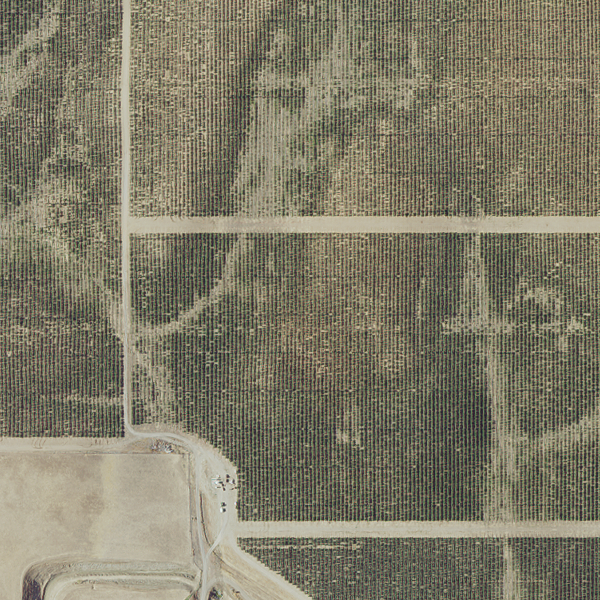

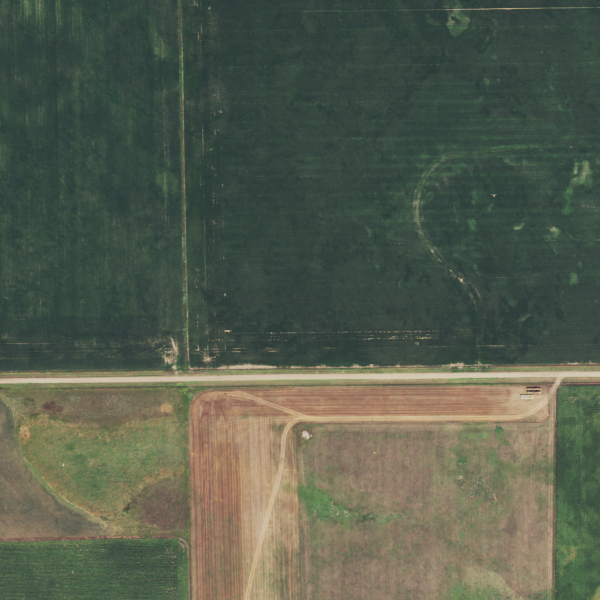

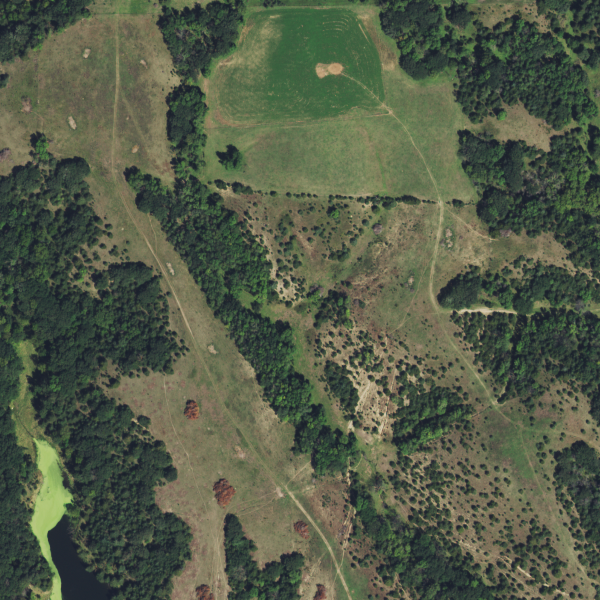

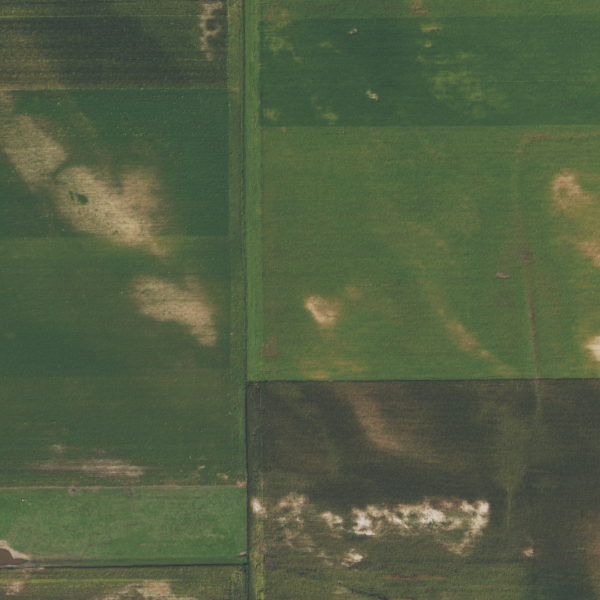

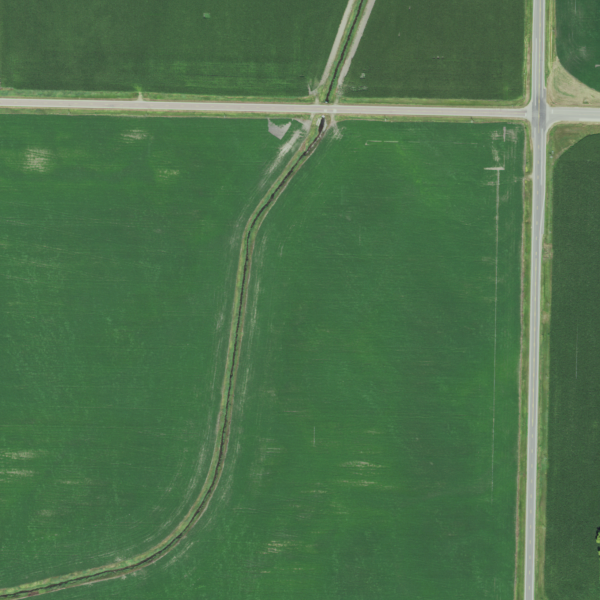

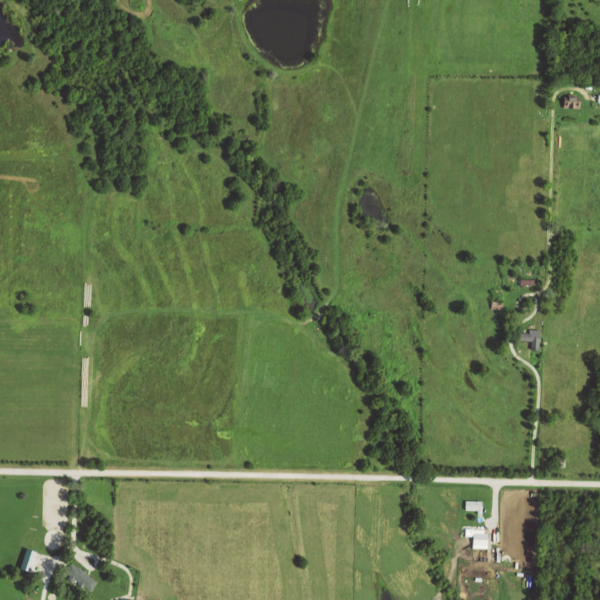

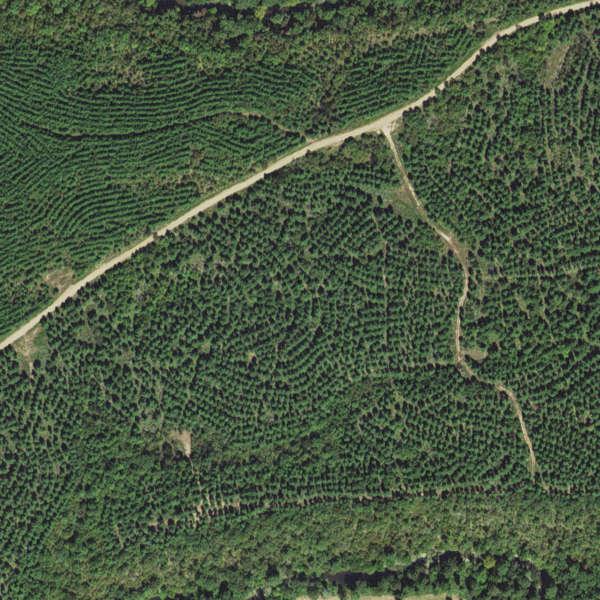

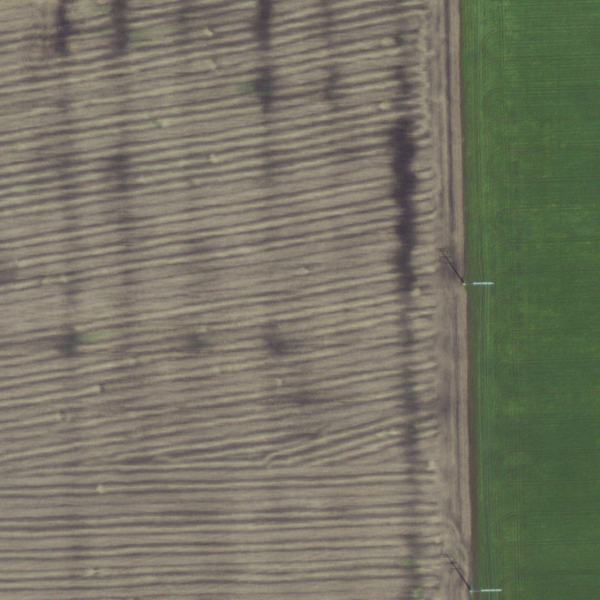

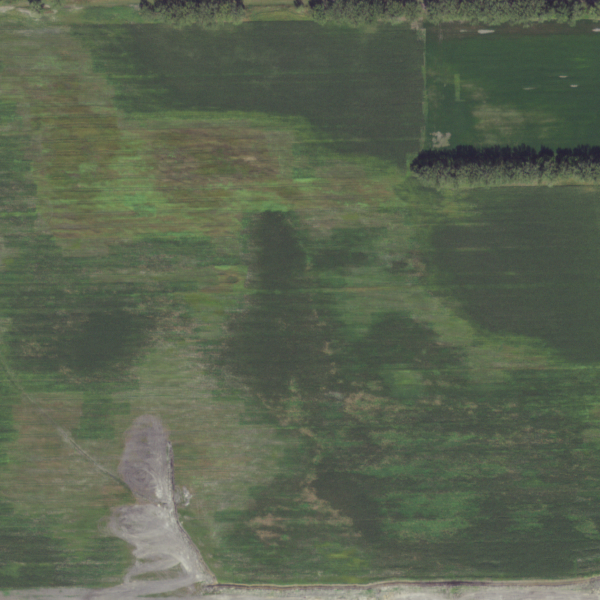

In [73]:
for path in agriculture:
    imarray = ima.load_image_as_rgb_array(path)[start_point:end_point,start_point:end_point]
    display(Image.fromarray(imarray))

## City: ~4 images of 7000 x 5000 pixels! Crop examples 

In [74]:
city = list_path_of_images_by_category(RAW_IMAGE_FOLDER, 'city')

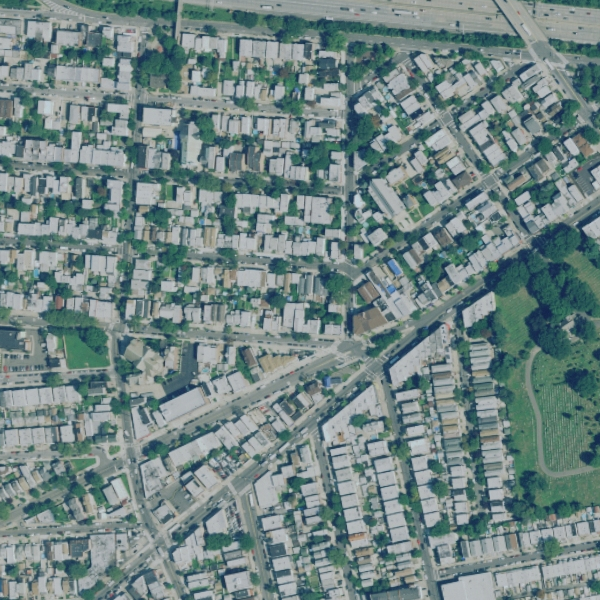

/Users/peterweber/Programs/anaconda2/envs/py3p6/lib/python3.6/site-packages/PIL/Image.py:2496: DecompressionBombWarning: Image size (118463180 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


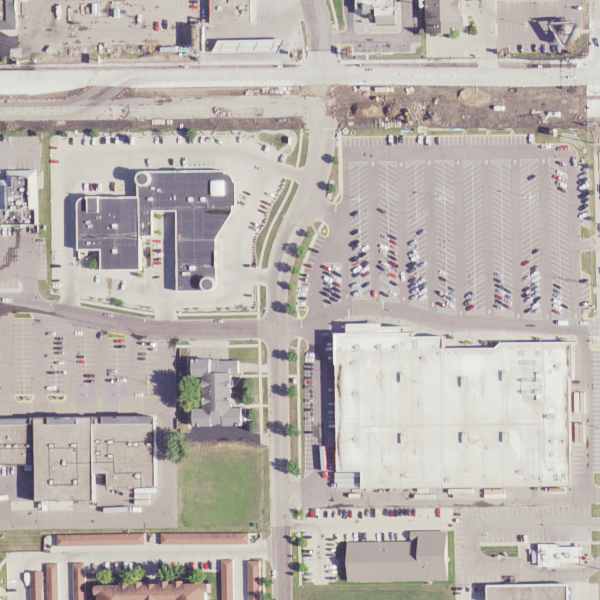

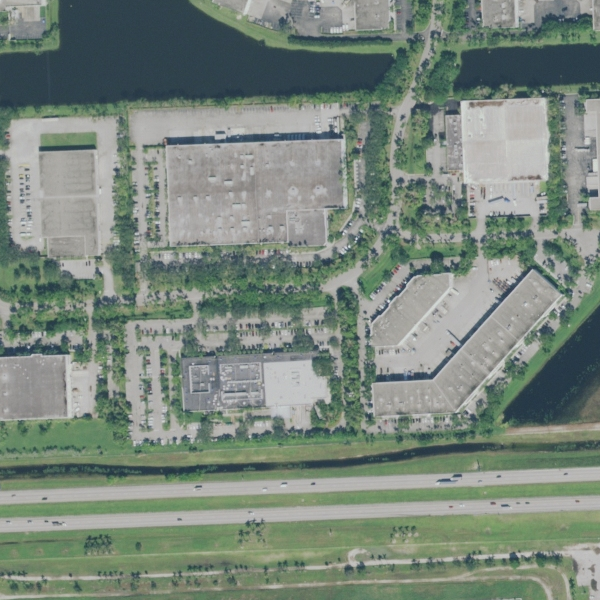

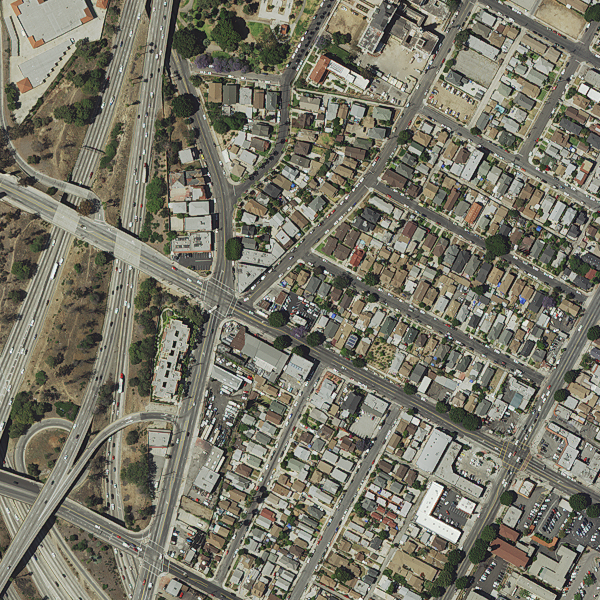

In [75]:
for path in city:
    imarray = ima.load_image_as_rgb_array(path)[start_point:end_point,start_point:end_point]
    display(Image.fromarray(imarray))

## Forest-woodland: ~6 images of 7000 x 5000 pixels! Crop examples

In [76]:
forest = list_path_of_images_by_category(RAW_IMAGE_FOLDER, 'forest-woodland')

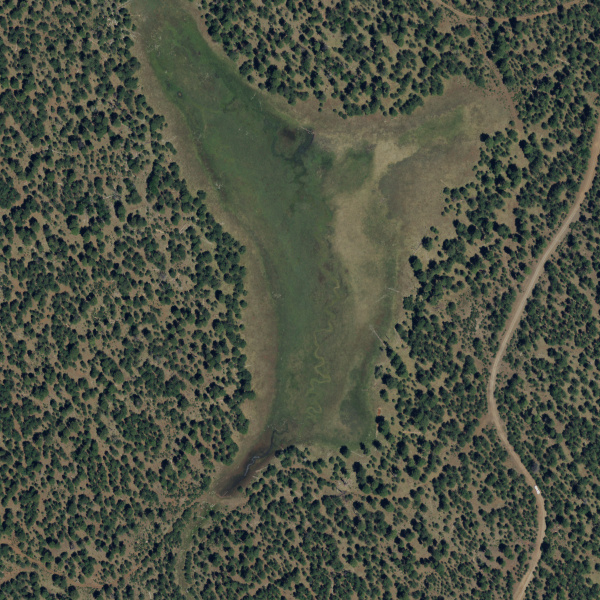

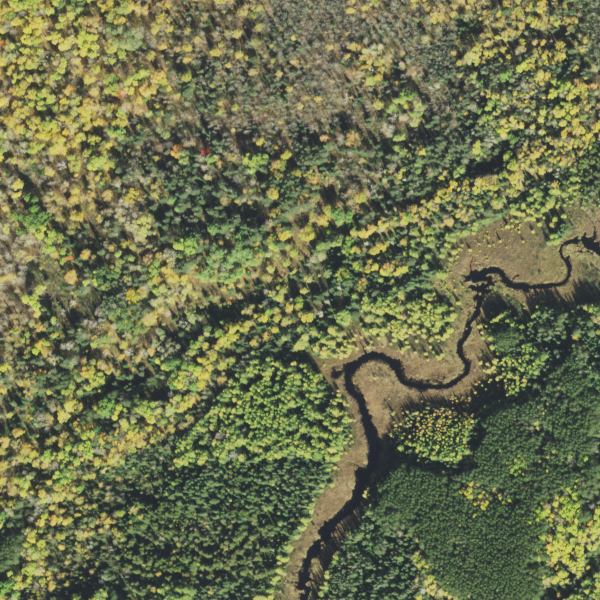

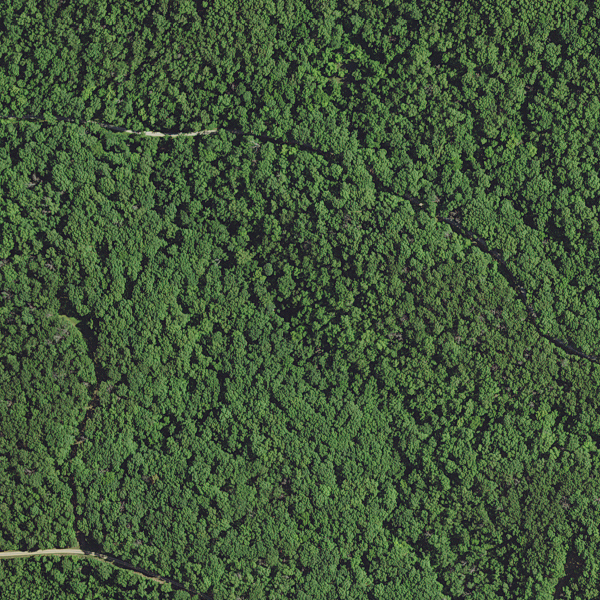

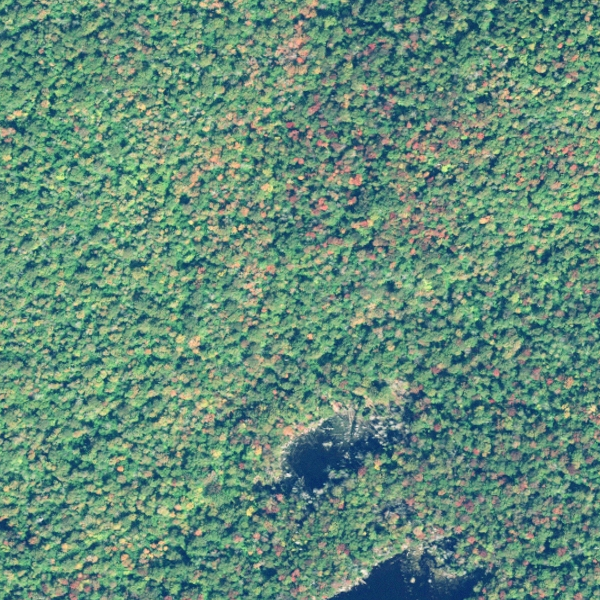

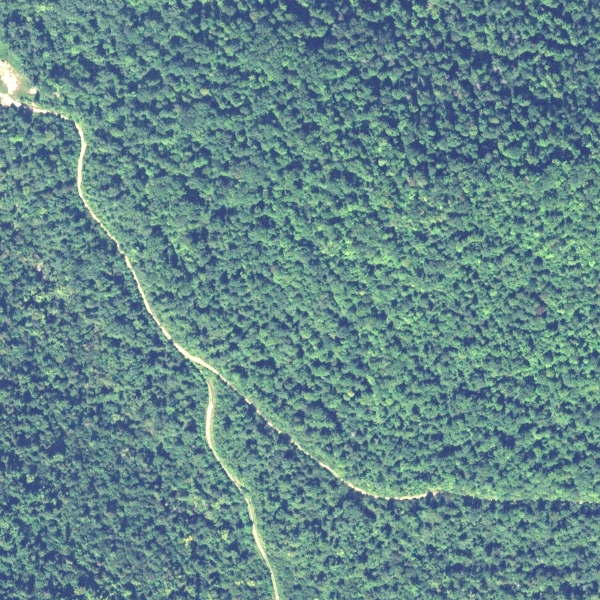

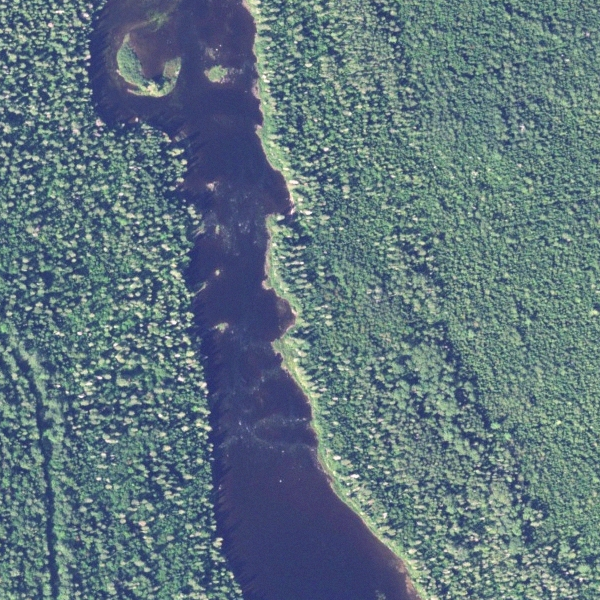

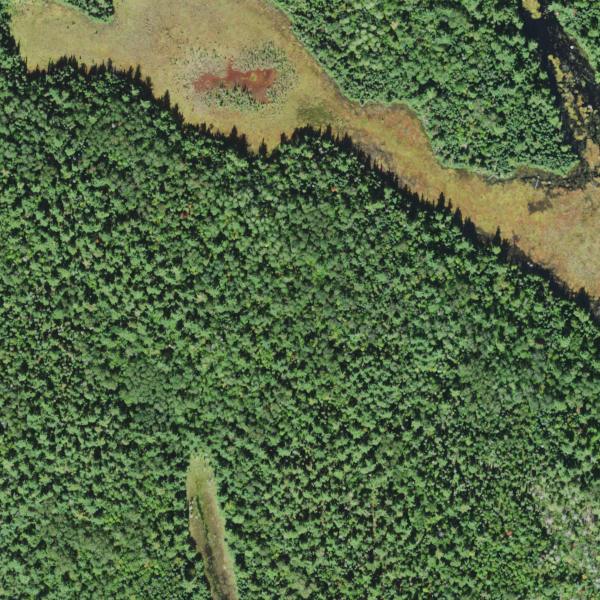

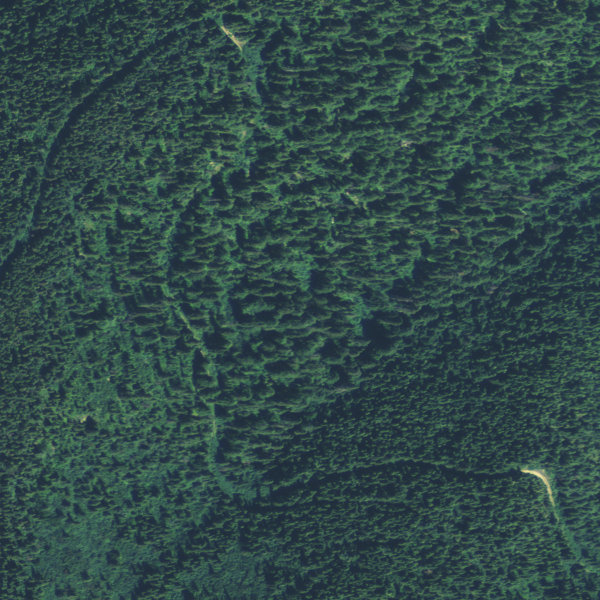

In [77]:
for path in forest:
    imarray = ima.load_image_as_rgb_array(path)[start_point:end_point,start_point:end_point]
    display(Image.fromarray(imarray))

## Semi-desert: ~6 images of 7000 x 5000 pixels! Crop examples 

In [78]:
desert = list_path_of_images_by_category(RAW_IMAGE_FOLDER, 'semi-desert')

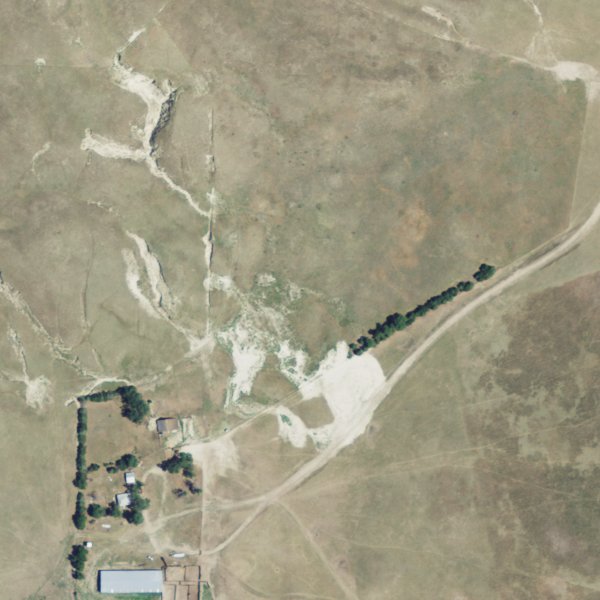

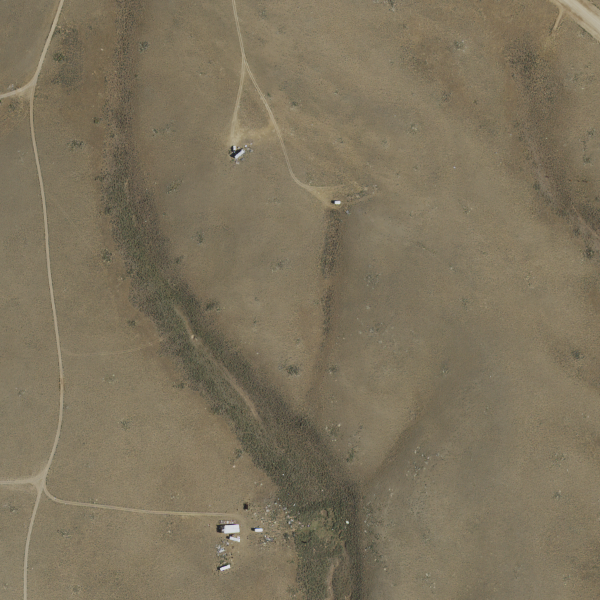

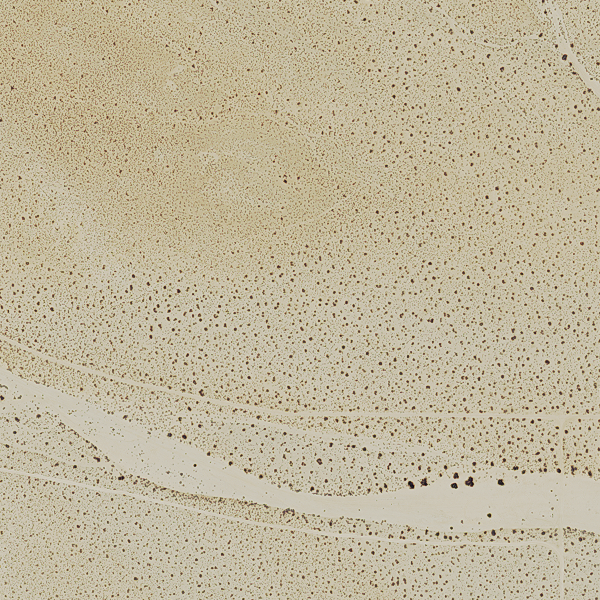

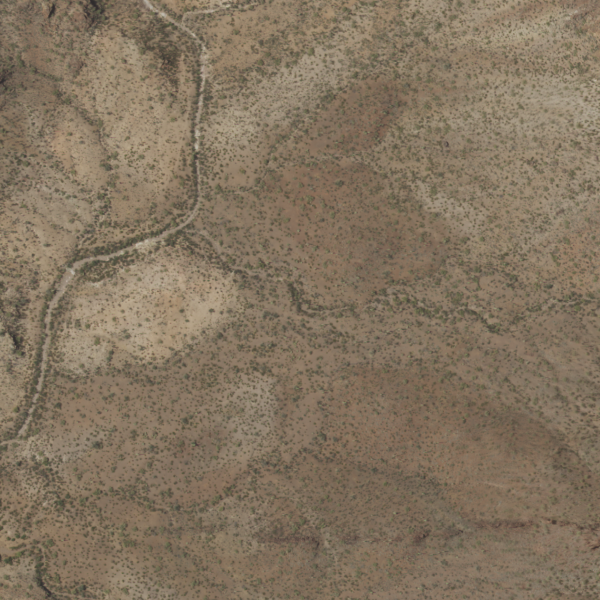

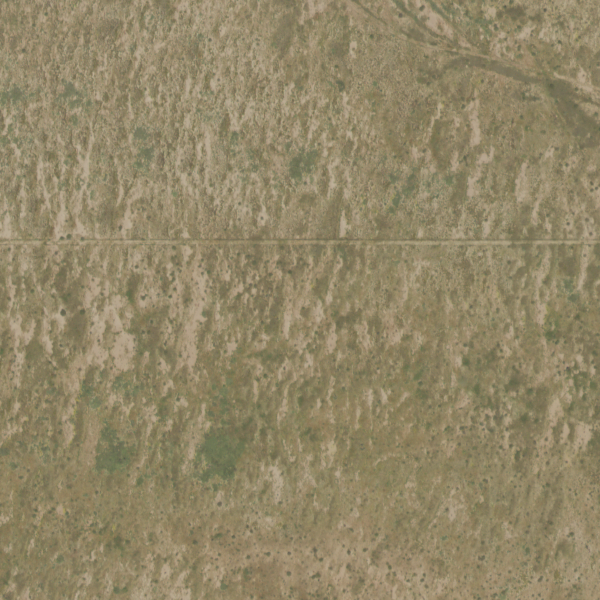

In [79]:
for path in desert:
    imarray = ima.load_image_as_rgb_array(path)[start_point:end_point,start_point:end_point]
    display(Image.fromarray(imarray))

## Shrubland-grassland: ~6 images of 7000 x 5000 pixels! Crop examples 

In [80]:
shrubland = list_path_of_images_by_category(RAW_IMAGE_FOLDER, 'shrubland-grassland')

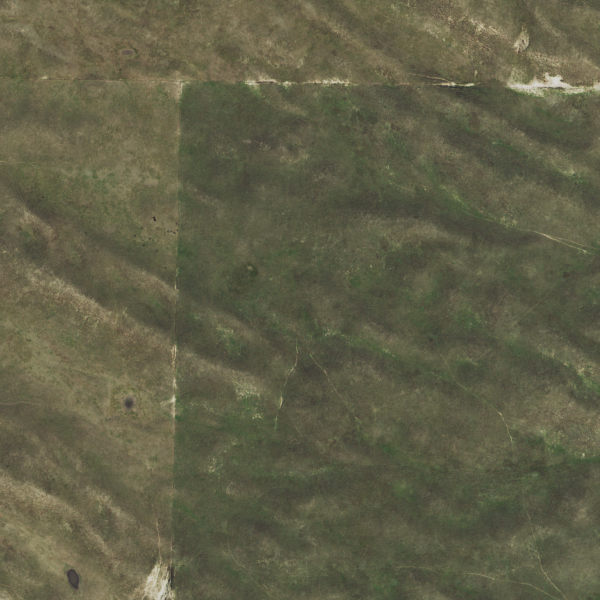

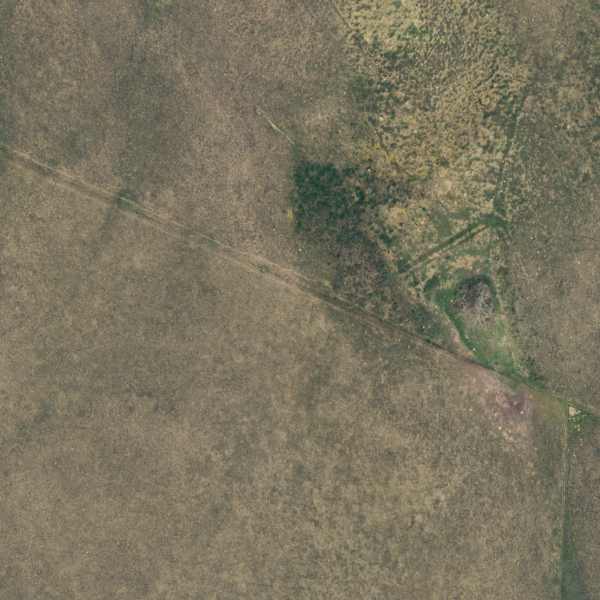

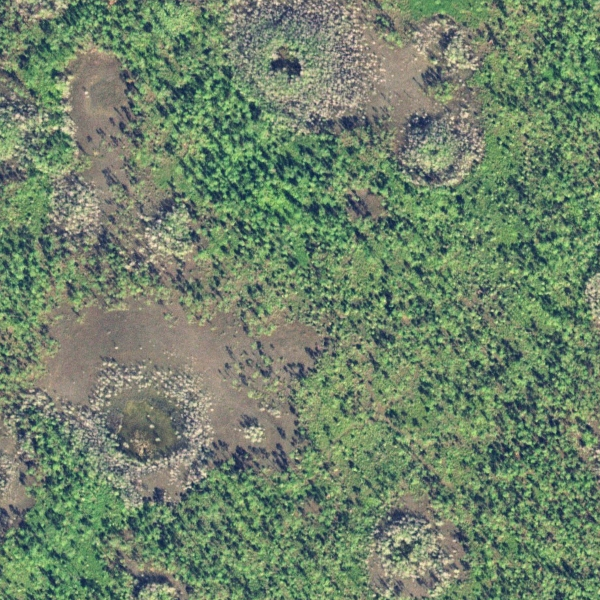

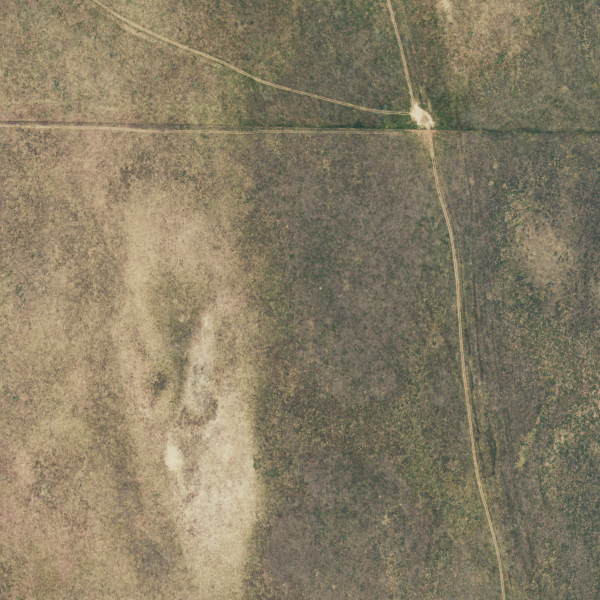

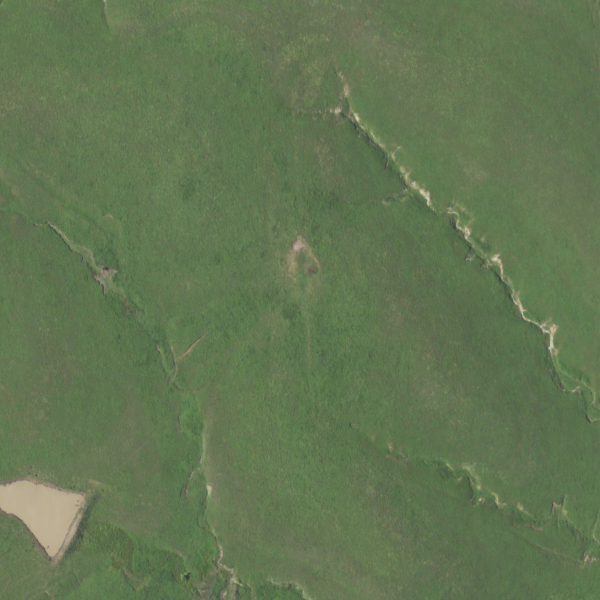

In [81]:
for path in shrubland:
    imarray = ima.load_image_as_rgb_array(path)[start_point:end_point,start_point:end_point]
    display(Image.fromarray(imarray))

# Produce image grid from large images (7000 x 5000 pixels)
### The resolution per pixel of all these images is 1m. Crop images of 256 x 256 pixels (meters), so that one large image yields ~600 small images.

In [4]:
size = 256
samples = 4

### Agriculture, data pipeline, show sampled examples

In [5]:
category = 'agriculture'
#imd.process_raw_images_and_save_usgs(agriculture, size, IMAGE_FOLDER + category)

In [6]:
paths = random.sample(list_path_of_images_by_category(IMAGE_FOLDER, category), samples)
print("There are", len(list_path_of_images_by_category(IMAGE_FOLDER, category)), "images with category", category)

There are 5879 images with category agriculture


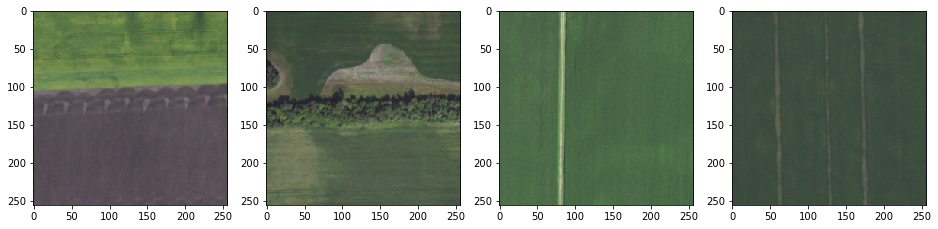

In [7]:
f,ax = plt.subplots(1,samples, figsize = (16,4))
for i, path in zip(range(samples), paths):
    ax[i].imshow(Image.open(path))

plt.show() # or display.display(plt.gcf()) if you prefer

### City, data pipeline, show sampled examples

In [8]:
category = 'city/'
#imd.process_raw_images_and_save_usgs(city, size, IMAGE_FOLDER + category)

In [9]:
paths = random.sample(list_path_of_images_by_category(IMAGE_FOLDER, category), samples)
print("There are", len(list_path_of_images_by_category(IMAGE_FOLDER, category)), "images with category", category)

There are 3910 images with category city/


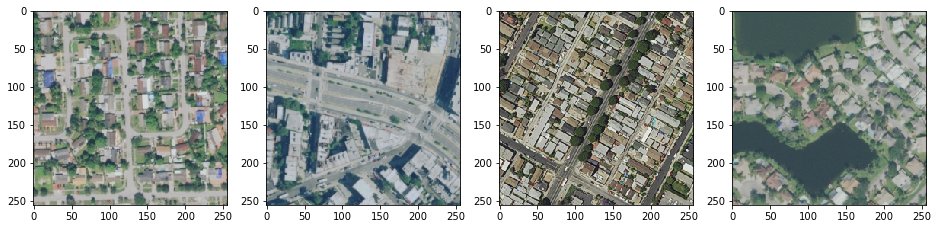

In [10]:
f,ax = plt.subplots(1,samples, figsize = (16,4))
for i, path in zip(range(samples), paths):
    ax[i].imshow(Image.open(path))

plt.show() # or display.display(plt.gcf()) if you prefer

### Forest, data pipeline, show sampled examples 

In [11]:
category = 'forest-woodland/'
#imd.process_raw_images_and_save_usgs(forest, size, IMAGE_FOLDER + category)

In [12]:
paths = random.sample(list_path_of_images_by_category(IMAGE_FOLDER, category), samples)
print("There are", len(list_path_of_images_by_category(IMAGE_FOLDER, category)), "images with category", category)

There are 5075 images with category forest-woodland/


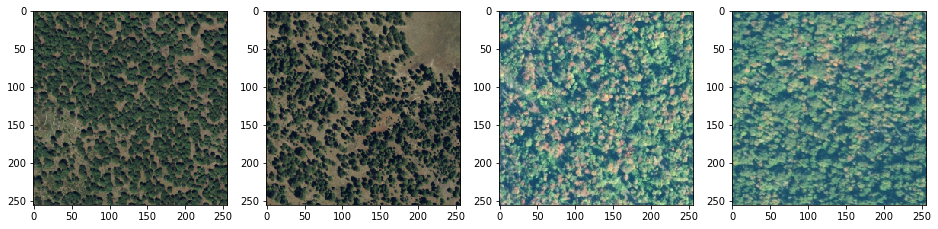

In [13]:
f,ax = plt.subplots(1,samples, figsize = (16,4))
for i, path in zip(range(samples), paths):
    ax[i].imshow(Image.open(path))

plt.show() # or display.display(plt.gcf()) if you prefer

### Desert, data pipeline, show sampled examples

In [14]:
category = 'semi-desert/'
#imd.process_raw_images_and_save_usgs(desert, size, IMAGE_FOLDER + category)

In [15]:
paths = random.sample(list_path_of_images_by_category(IMAGE_FOLDER, category), samples)
print("There are", len(list_path_of_images_by_category(IMAGE_FOLDER, category)), "images with category", category)

There are 3555 images with category semi-desert/


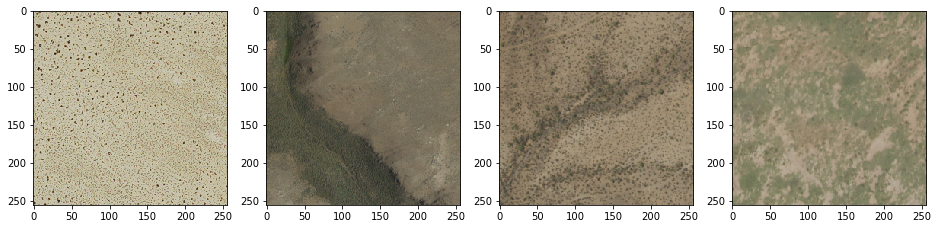

In [16]:
f,ax = plt.subplots(1,samples, figsize = (16,4))
for i, path in zip(range(samples), paths):
    ax[i].imshow(Image.open(path))

plt.show() # or display.display(plt.gcf()) if you prefer

### Shrubland, data pipeline, show sampled examples

In [17]:
category = 'shrubland-grassland/'
#imd.process_raw_images_and_save_usgs(shrubland, size, IMAGE_FOLDER + category)

In [18]:
paths = random.sample(list_path_of_images_by_category(IMAGE_FOLDER, category), samples)
print("There are", len(list_path_of_images_by_category(IMAGE_FOLDER, category)), "images with category", category)

There are 3475 images with category shrubland-grassland/


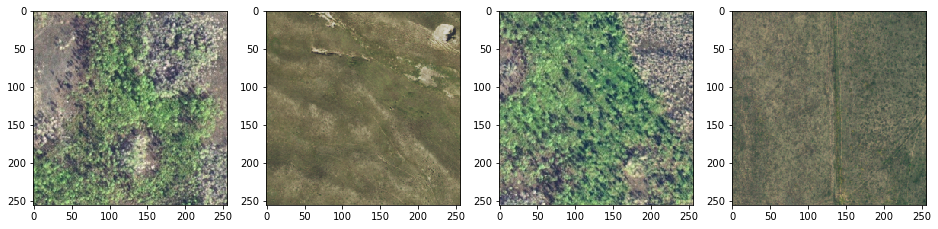

In [19]:
f,ax = plt.subplots(1,samples, figsize = (16,4))
for i, path in zip(range(samples), paths):
    ax[i].imshow(Image.open(path))

plt.show() # or display.display(plt.gcf()) if you prefer

# Label Images

TBD

# Degrade images example

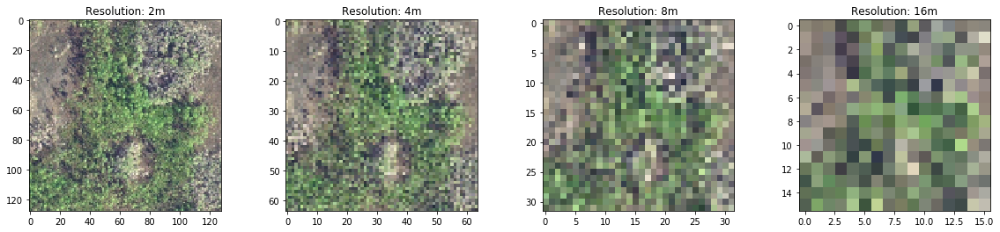

In [20]:
path = paths[0]
num_degrade = 4
f,ax = plt.subplots(1, num_degrade, figsize = (20,4))
for i in range(num_degrade):
    factor = 2 ** (i + 1)
    image = ima.reduce_image_quality(Image.open(path), factor)
    ax[i].imshow(Image.fromarray(image))
    ax[i].set_title("Resolution: {}m".format(factor))

plt.show() # or display.display(plt.gcf()) if you prefer

# Compute Gist
TBD for all images

# Image WITH human impact from every category

In [21]:
human = [
    'agriculture/m_4209830_se_14_1_20140907_x3421_y1886.png',
    'city/m_2508006_ne_17_1_20171030_x322_y376.png',
    'forest-woodland/m_3310920_nw_12_1_20150603_x108_y4919.png',
    'semi-desert/m_3010358_ne_13_1_20161005_x864_y3617.png',
    'shrubland-grassland/m_3810422_ne_13_1_20170826_x2138_y3439.png'
]

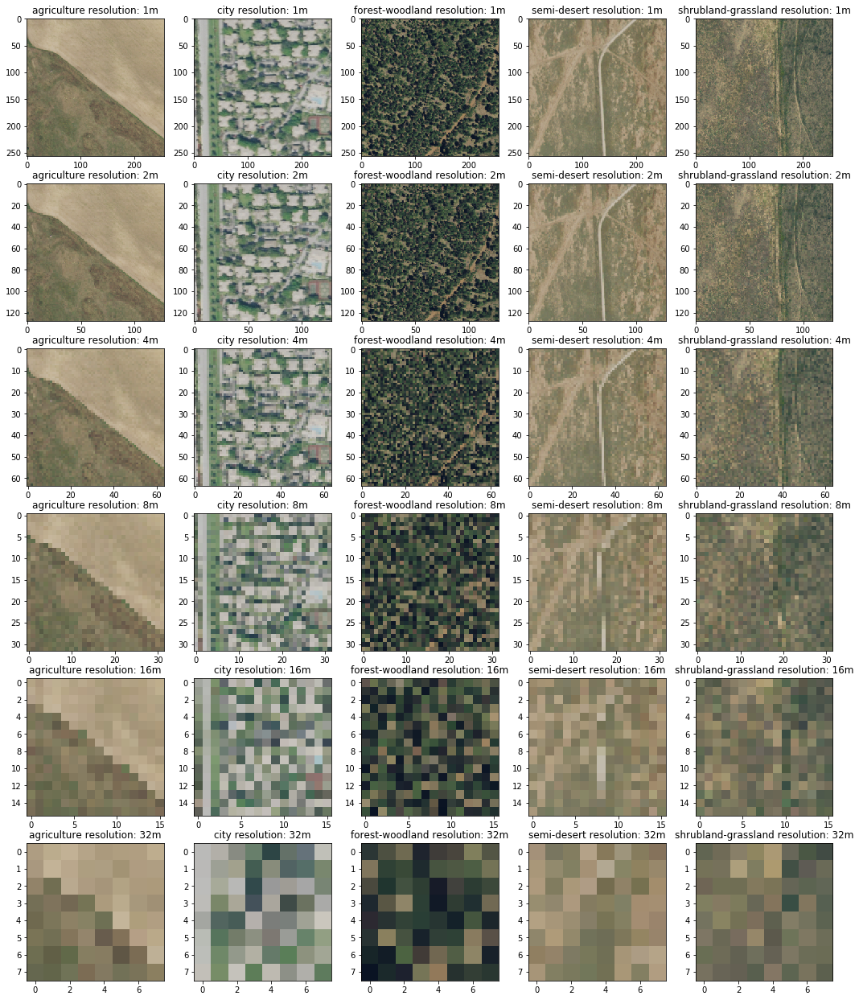

In [60]:
num = len(human)
factors = [2 ** i for i in range(6)]
f,ax = plt.subplots(len(factors), num, figsize = (18,22))

for col in range(num):
    for row in range(len(factors)):
        factor = factors[row]
        image = Image.open(IMAGE_FOLDER + human[col])
        image = Image.fromarray(ima.reduce_image_quality(image, factor))
        image.save("../Matlab/images/human_row={}_col={}.png".format(row, col))
        ax[row, col].imshow(image)
        ax[row, col].set_title(" ".join([human[col].split("/")[0], 'resolution: {}m'.format(factor)]))
plt.show() 

## Visualize Gist for these images

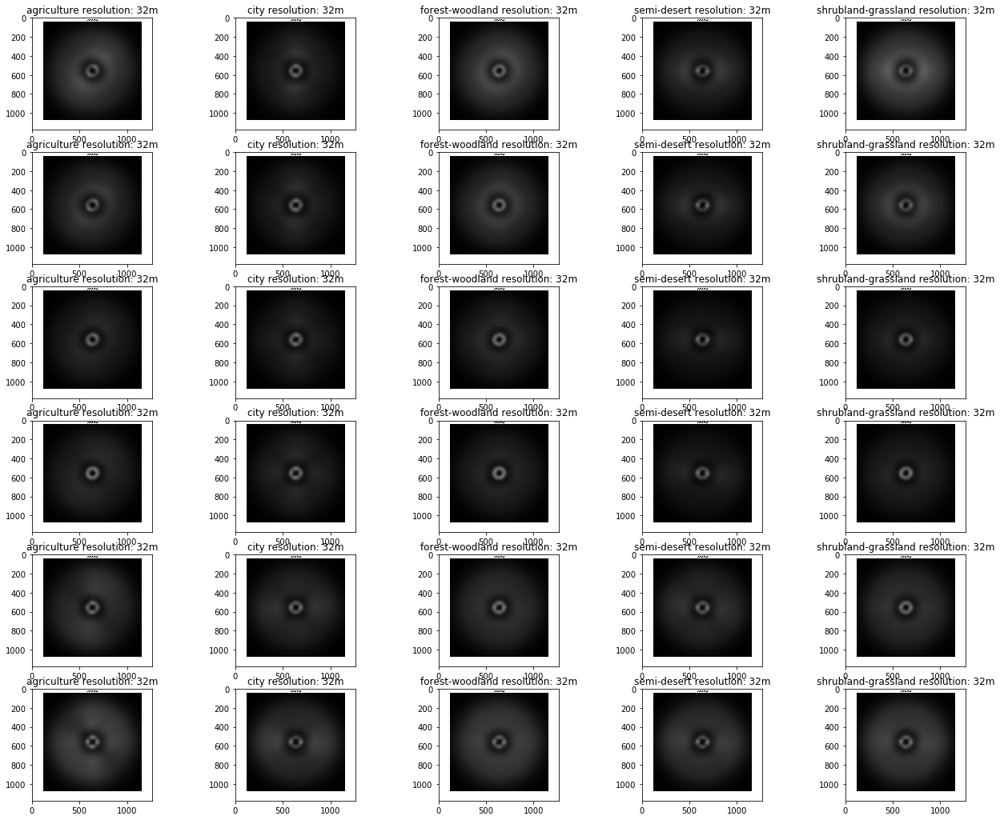

In [62]:
num = len(human)
f,ax = plt.subplots(6, num, figsize = (22,18))

for col in range(num):
    for row in range(6):
        image = Image.open('../Matlab/images/human_row={}_col={}_gist.png'.format(row, col))
        ax[row, col].imshow(image)
        ax[row, col].set_title(" ".join([human[col].split("/")[0], 'resolution: {}m'.format(factor)]))
plt.show()

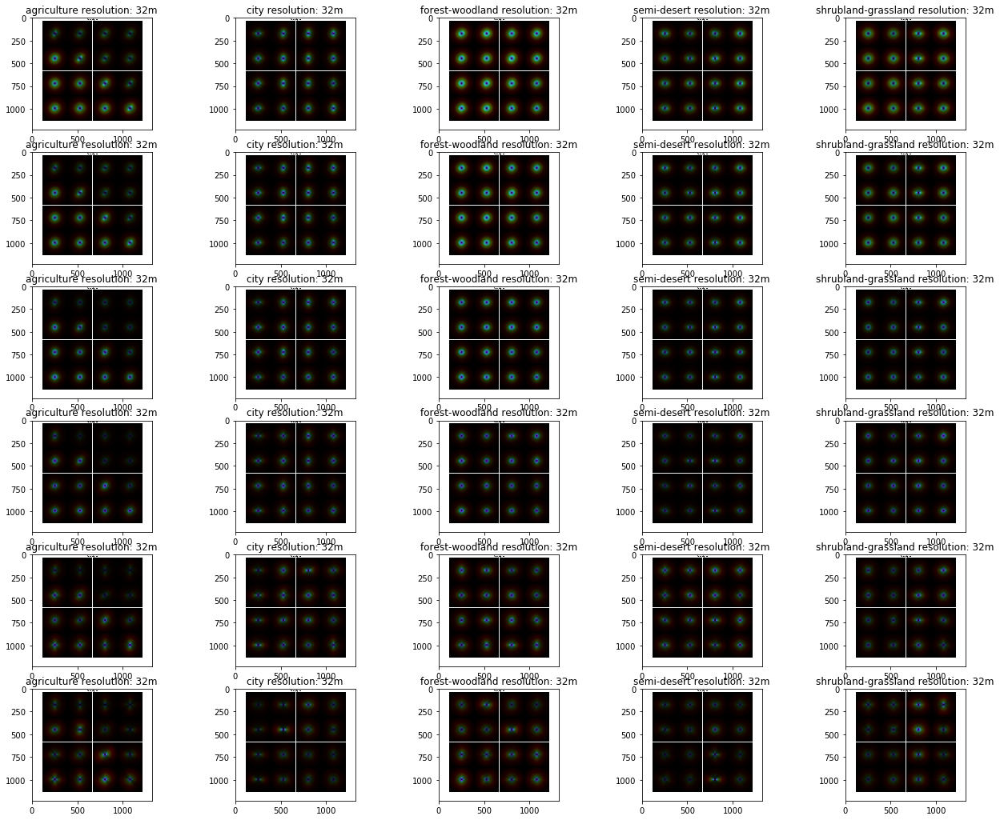

In [66]:
num = len(human)
f,ax = plt.subplots(6, num, figsize = (22,18))

for col in range(num):
    for row in range(6):
        image = Image.open('../Matlab/images/human_row={}_col={}_gist.png'.format(row, col))
        ax[row, col].imshow(image)
        ax[row, col].set_title(" ".join([human[col].split("/")[0], 'resolution: {}m'.format(factor)]))
plt.show()

# Images WITHOUT human impact from every category (if available)

In [53]:
nohuman = [
    'agriculture/m_4209830_se_14_1_20140907_x3421_y606.png',
    'forest-woodland/m_3310920_nw_12_1_20150603_x108_y55.png',
    'semi-desert/m_3010358_ne_13_1_20161005_x96_y801.png',
    'shrubland-grassland/m_3810422_ne_13_1_20170826_x2138_y2671.png'
]

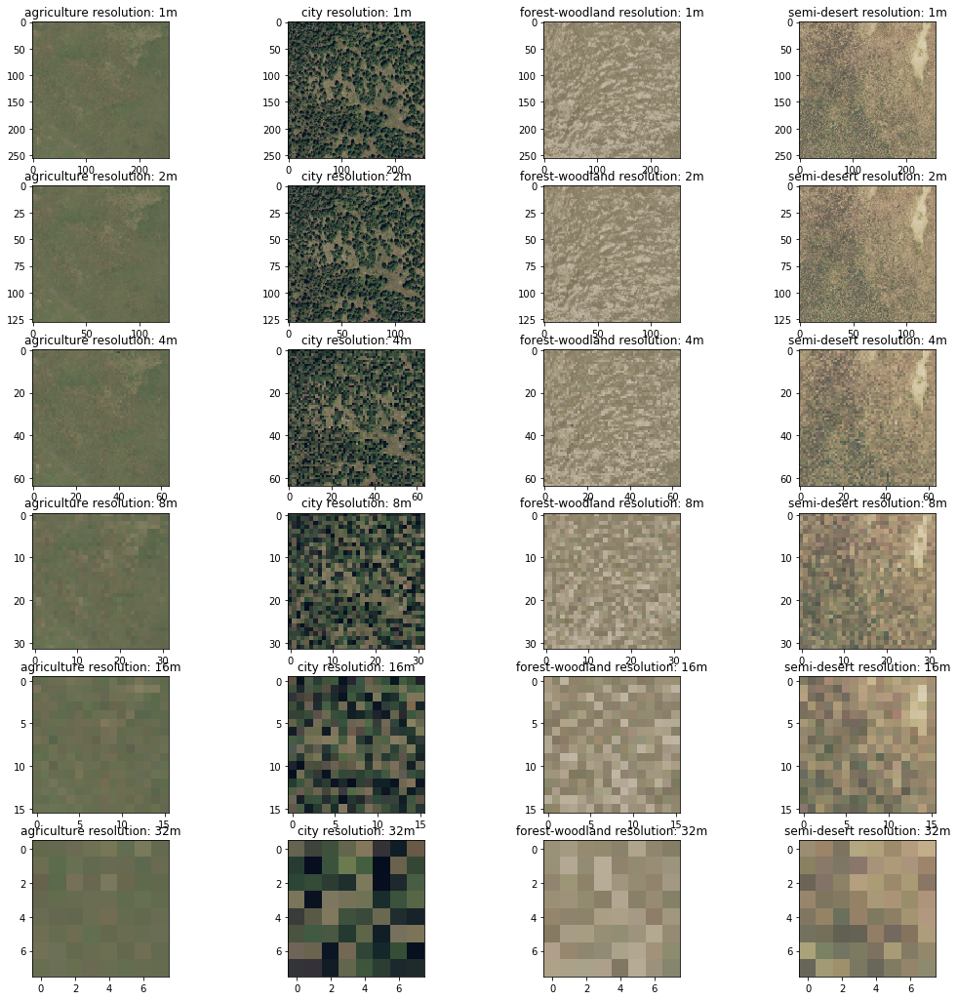

In [61]:
num = len(nohuman)
factors = [2 ** i for i in range(6)]
f,ax = plt.subplots(len(factors), num, figsize = (18,18))

for col in range(num):
    for row in range(len(factors)):
        factor = factors[row]
        image = Image.open(IMAGE_FOLDER + nohuman[col])
        image = Image.fromarray(ima.reduce_image_quality(image, factor))
        image.save("../Matlab/images/nohuman_row={}_col={}.png".format(row, col))
        ax[row, col].imshow(image)
        ax[row, col].set_title(" ".join([human[col].split("/")[0], 'resolution: {}m'.format(factor)]))
plt.show() 

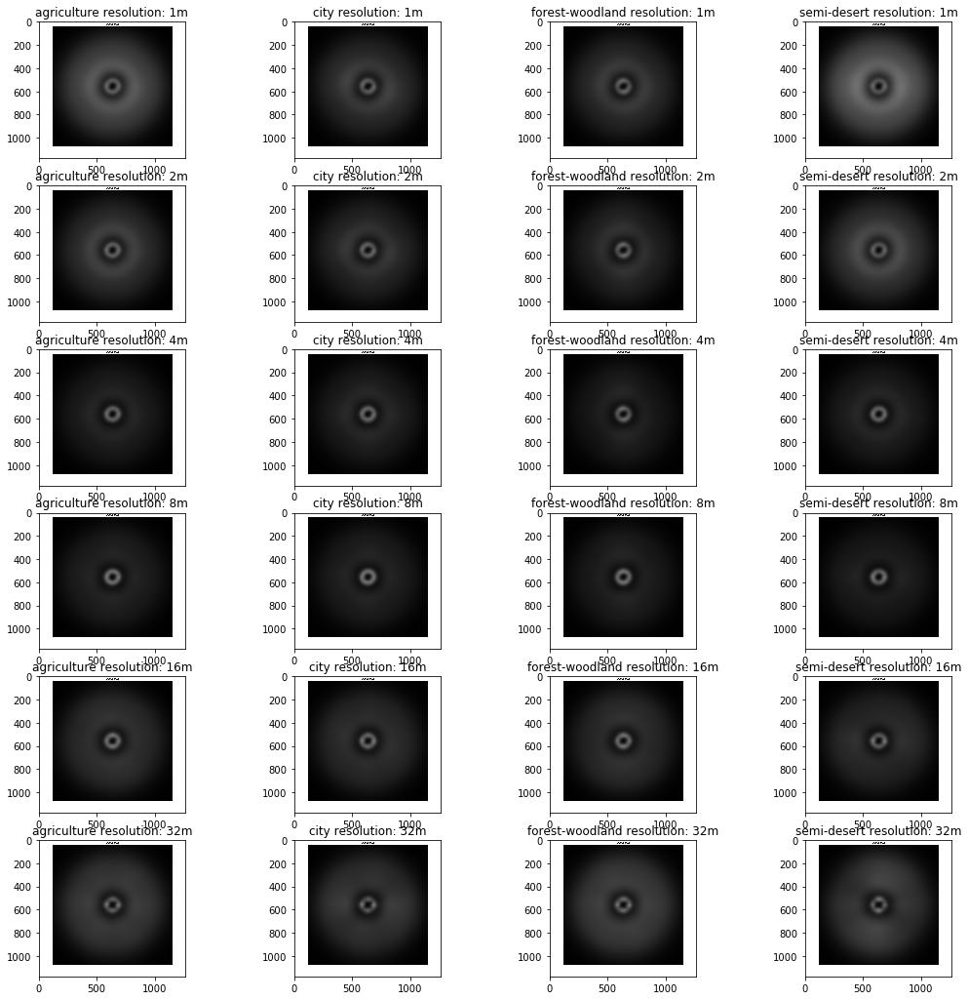

In [64]:
num = len(nohuman)
f,ax = plt.subplots(6, num, figsize = (18,18))

for col in range(num):
    for row in range(6):
        factor = factors[row]
        image = Image.open('../Matlab/images/nohuman_row={}_col={}_gist.png'.format(row, col))
        ax[row, col].imshow(image)
        ax[row, col].set_title(" ".join([human[col].split("/")[0], 'resolution: {}m'.format(factor)]))
plt.show() 

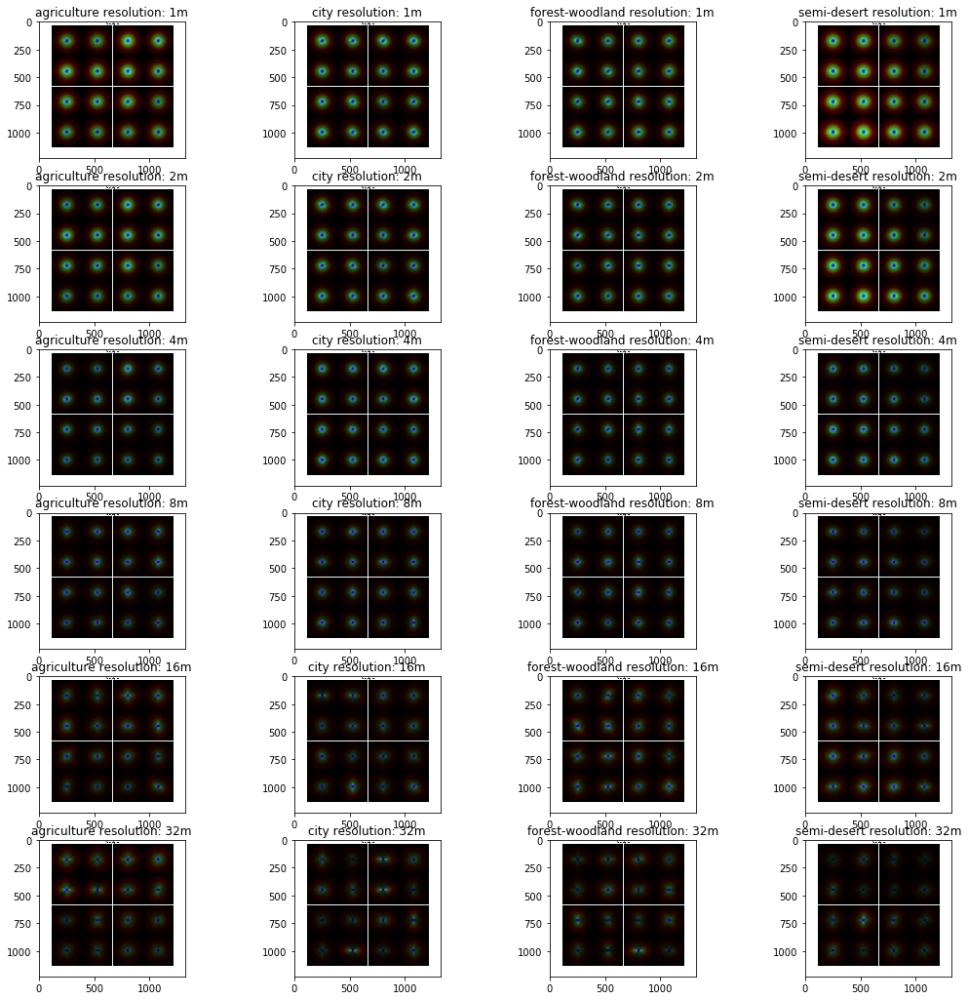

In [65]:
num = len(nohuman)
f,ax = plt.subplots(6, num, figsize = (18,18))

for col in range(num):
    for row in range(6):
        factor = factors[row]
        image = Image.open('../Matlab/images/nohuman_row={}_col={}_gist.png'.format(row, col))
        ax[row, col].imshow(image)
        ax[row, col].set_title(" ".join([human[col].split("/")[0], 'resolution: {}m'.format(factor)]))
plt.show() 

# Next steps
- automate image manipulation and access earthexplorer.usgs.gov api
- label all images
- compute gist for all images
- translate matlab code of gist to python or use matlab API in python
- compute distance between GIST images and classify/cluster them
- use convnets and compute mutual information